In [ ]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # Clone the github ropository of the YOLOv5 creators - Ultralytics
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow          # Install roboflow to import the dataset

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 14927, done.
remote: Counting objects: 100% (19/19), done.
remote: Compressing objects: 100% (17/17), done.
remote: Total 14927 (delta 7), reused 12 (delta 2), pack-reused 14908
Receiving objects: 100% (14927/14927), 14.00 MiB | 31.23 MiB/s, done.
Resolving deltas: 100% (10254/10254), done.
/content/yolov5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.0/184.0 KB 18.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 76.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.7/45.7 KB 6.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 KB 7.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 KB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.5/138.5 KB 15.8 MB/s eta 0:00:00
Setup complete. Using torch 1.13.0+c

In [ ]:
# Import roboflow

from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="ultralytics")

upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


In [ ]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

In [ ]:
# Mount my google drive to the runtime so that I can save results
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Weights & Biases
# Connect weights and biased to track the training of the model and save training results/graphs for later use
%pip install -q wandb
import wandb
wandb.login(key="--------")  # Removed for privacy
wandb.init(project="Apple Detector", entity="trowland")


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 33.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 174.3/174.3 KB 25.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 140.6/140.6 KB 20.1 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
roboflow 0.2.22 requires urllib3==1.26.6, but you have urllib3 1.26.13 which is incompatible.


ERROR:wandb.jupyter:Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: trowland. Use `wandb login --relogin` to force relogin


In [ ]:
# Download the dataset from my Roboflow account to the google colab runtime
rf = Roboflow(api_key="yx4HTqTWuj2cxx44fsYG")
project = rf.workspace("apples-eq4ml").project("apple-detector-zifef")
dataset = project.version(3).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/Apple-Detector-3 in yolov5pytorch:: 100%|██████████| 674/674 [00:00<00:00, 1623.97it/s]


In [ ]:
# Train the model
!python train.py --img 640 --batch 16 --epochs 85 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache  --patience 200 

wandb: Currently logged in as: trowland. Use `wandb login --relogin` to force relogin
train: weights=yolov5s.pt, cfg=, data=/content/datasets/Apple-Detector-3/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=85, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=200, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-56-gc0ca1d2 Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05,

In [ ]:
# Start tensorboard to view the training graphs at the end of training

%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
# Use detect.py to run inference with the newly trained weights
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 640 --conf 0.25 --source {dataset.location}/test/images

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/datasets/Apple-Detector-3/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-56-gc0ca1d2 Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/32 /content/datasets/Apple-Detector-3/test/images/dataset1_back_1081_png.rf.61ad8a45c7a6cfefce41e0ae4aa209f1.jpg: 640x640 32 apples, 12.3ms
image 2/32 /content/datasets/Apple-Detector-3/test/images/dataset1_back_1141_png.rf.0216021bb8e9179983fb45da0c6fa934.jpg: 640x640 35 apples, 12.3ms
image 3/

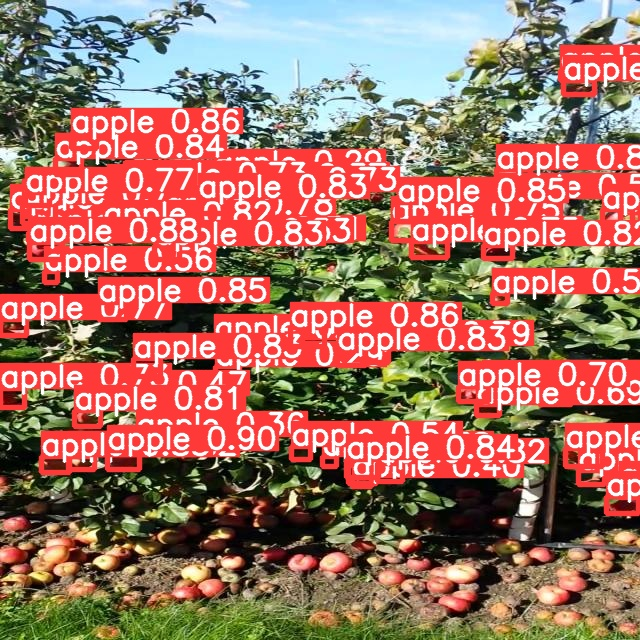

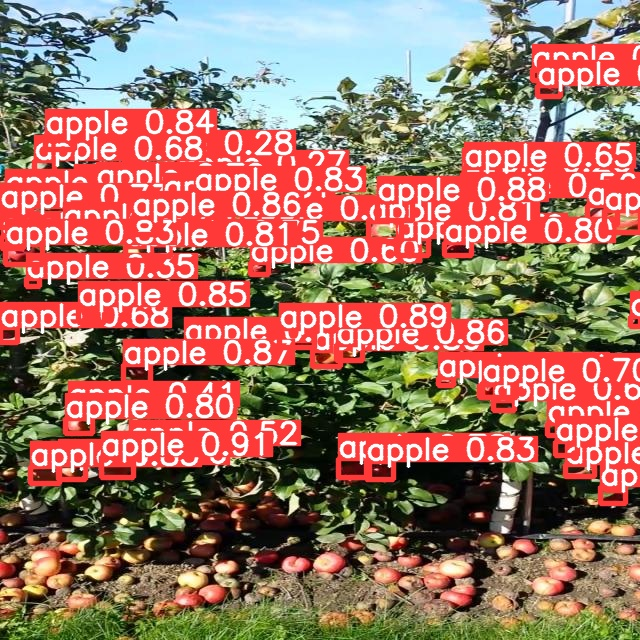

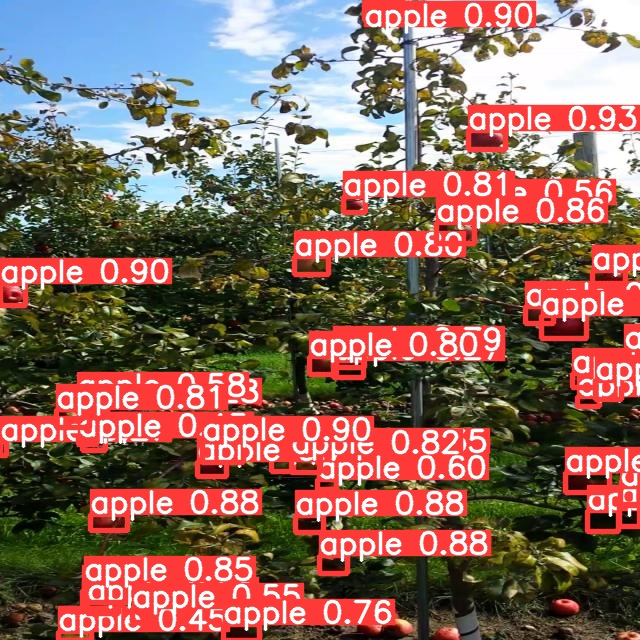

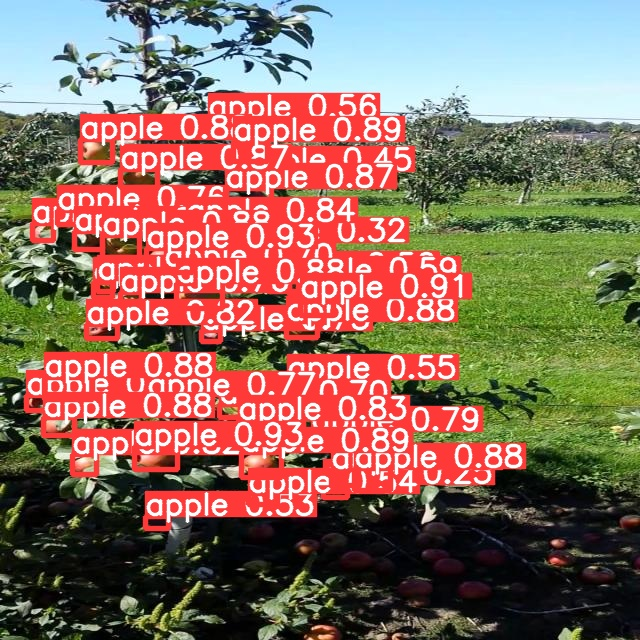

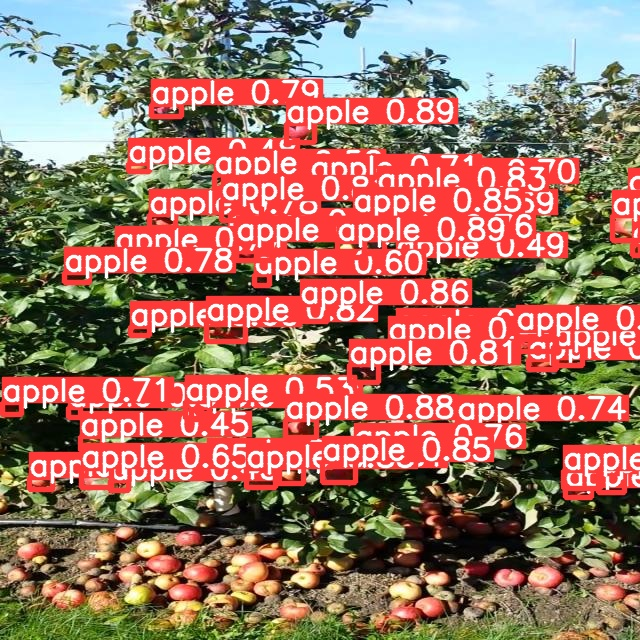

...

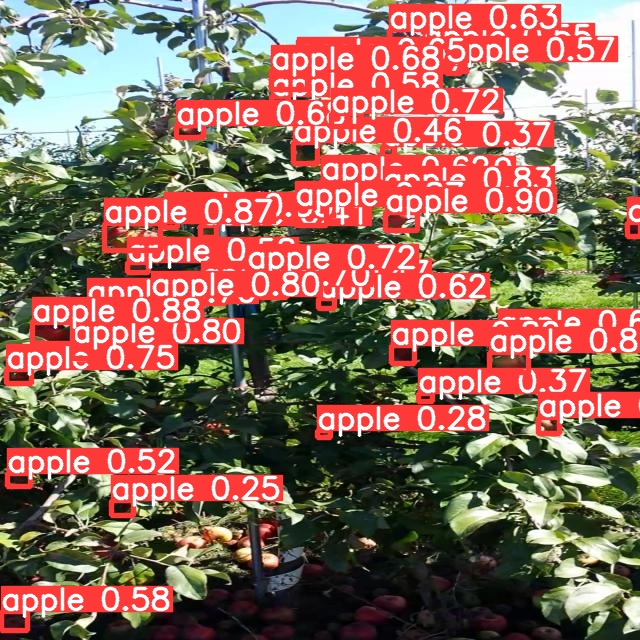

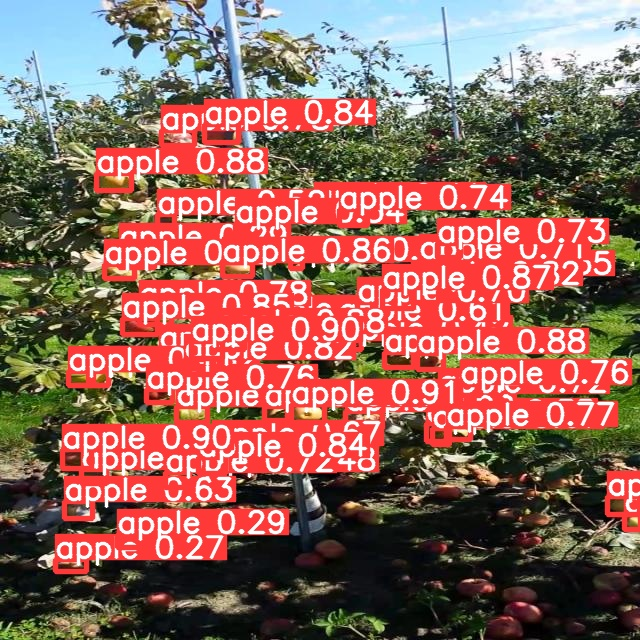

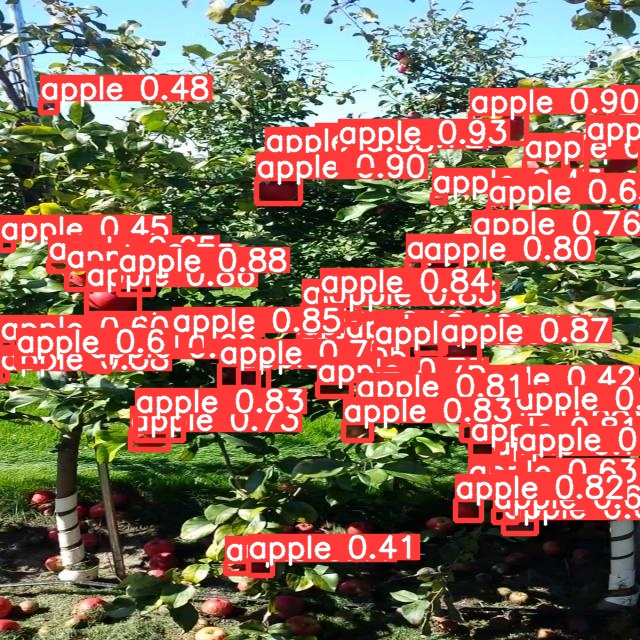

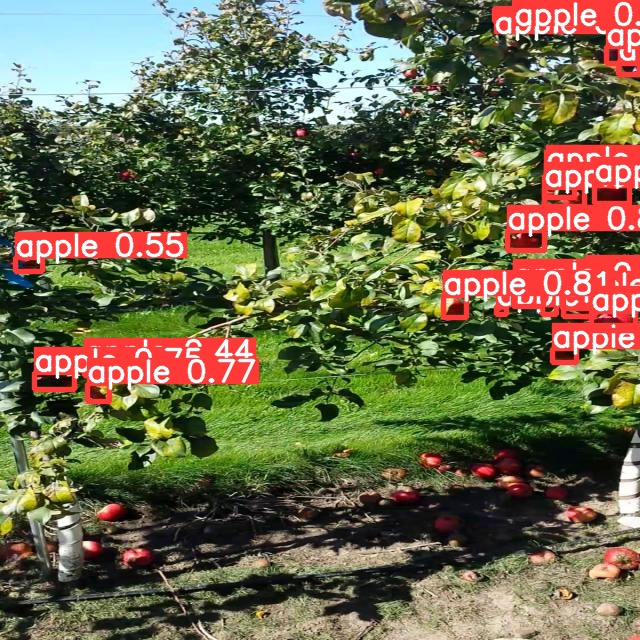

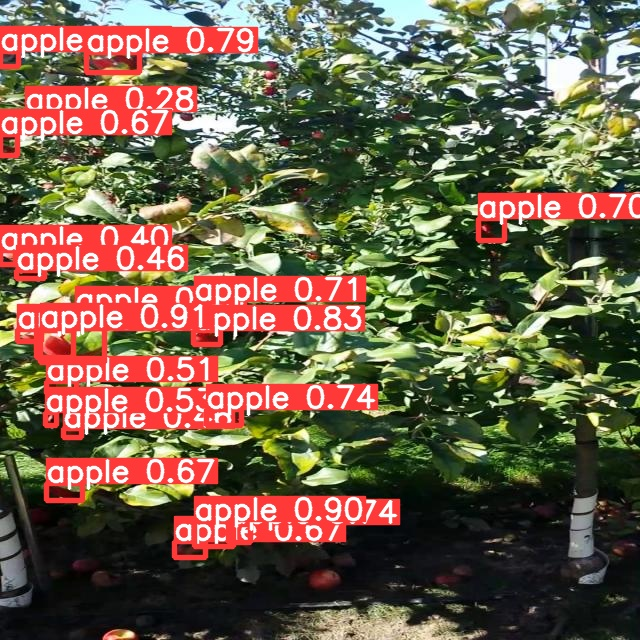

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp4/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
#export the newly trained weights for any future inference
from google.colab import files
files.download('./runs/train/exp2/weights/best.pt')

FileNotFoundError: ignored

In [ ]:
# Zip up all of the training information ready for download

!zip -r /content/exp2.zip /content/yolov5/runs/train/exp2
from google.colab import files
files.download("/content/exp2.zip")

In [ ]:
# Zip up inference images ready for download
!zip -r /content/file.zip /content/yolov5/runs/detect/exp4

In [ ]:
# Download files
from google.colab import files
files.download("/content/file.zip")